In [1]:
import pandas as pd 
import numpy as np
import networkx as nx
import ast
from tqdm import tqdm
from sklearn.model_selection import GroupKFold
import matplotlib.pyplot as plt
import seaborn as sns
from statsmodels.stats.outliers_influence import variance_inflation_factor
from statsmodels.tools.tools import add_constant

tqdm.pandas()

In [2]:
import sys
sys.path.append('../scripts/')

In [3]:
from feature_creation import *

In [4]:
df = pd.read_csv('../data/train.csv')

In [3]:
df.language.value_counts()

language
Japanese      500
German        500
Arabic        500
Portuguese    500
Chinese       500
Czech         500
Turkish       500
Thai          500
Polish        500
Korean        500
Icelandic     500
Finnish       500
Spanish       500
Swedish       500
Indonesian    500
Italian       500
French        500
Hindi         500
English       500
Galician      500
Russian       500
Name: count, dtype: int64

In [4]:
df.sentence.value_counts()

sentence
2      21
662    21
684    21
680    21
679    21
       ..
310    21
309    21
306    21
303    21
995    21
Name: count, Length: 500, dtype: int64

In [5]:
df.n.describe()

count    10500.000000
mean        18.807524
std          8.190593
min          3.000000
25%         13.000000
50%         18.000000
75%         23.000000
max         70.000000
Name: n, dtype: float64

## Data Preparation

In [6]:
language_to_group = {
    "English": "Germanic",
    "German": "Germanic",
    "Swedish": "Germanic",
    "Icelandic": "Germanic",

    "French": "Romance",
    "Spanish": "Romance",
    "Italian": "Romance",
    "Portuguese": "Romance",
    "Galician": "Romance",

    "Russian": "Slavic",
    "Polish": "Slavic",
    "Czech": "Slavic",

    "Finnish": "Uralic",

    "Turkish": "Turkic",

    "Hindi": "Indo-Aryan",

    "Japanese": "Japonic",

    "Korean": "Koreanic",

    'Chinese': 'Sino-Tibetan',

    "Indonesian": "Austronesian",

    'Arabic': 'Semitic',

    "Thai": "Kra-Dai"
}

In [7]:
df['family_group'] = df['language'].apply(lambda x:language_to_group[x])

In [8]:
def graph_features(edgelist):

    T = nx.from_edgelist(edgelist)
    
    avg_path_length = nx.average_shortest_path_length(T)
    diameter = nx.diameter(T)
    num_edges = T.number_of_edges()
    density = nx.density(T)

    n = T.number_of_nodes()
    average_degree = (2 * num_edges) / n

    return {
            "avg_path_length": avg_path_length,
            "diameter": diameter,
            "num_edges": num_edges,
            "density": density,
            "average_degree": average_degree
            }


In [21]:
def node_features(edgelist):

    T = nx.from_edgelist(edgelist)

    eccentricity = nx.eccentricity(T)

    degree_cent = nx.degree_centrality(T)
    harmoni_cent = nx.harmonic_centrality(T)
    betweeness_cent = nx.betweenness_centrality(T)
    page_cent = nx.pagerank(T)
    eigen_cent = nx.eigenvector_centrality(T, max_iter=10000)
    closeness_cent = nx.closeness_centrality(T)
    katz_cent = nx.katz_centrality(T,max_iter=10000)
    information_cent = nx.information_centrality(T)
    load_centrality = nx.load_centrality(T)
    subgraph_cent = nx.subgraph_centrality(T)
    comm_betweenness = nx.communicability_betweenness_centrality(T)
    current_flow_closeness = nx.current_flow_closeness_centrality(T)
    current_flow_betweenness = nx.current_flow_betweenness_centrality(T)
    second_order_cent = nx.second_order_centrality(T)


    
    degree = T.degree()
    core_numbers = nx.core_number(T)

    

    avg_shortest_path_length = {}
    for node in T.nodes():
        avg_path_length = sum(nx.shortest_path_length(T, source=node).values()) / (len(T) - 1)
        avg_shortest_path_length[node] = avg_path_length


    effective_size = nx.effective_size(T)

    vote_rank = nx.voterank(T)
    vote_rank_score ={}
    for i, node in enumerate(vote_rank):
        vote_rank_score[node] = len(T) - i
    for node in T.nodes():
        if node not in vote_rank_score:
                vote_rank_score[node] = 0



    is_leaf = {node: (T.degree[node] == 1) for node in T.nodes} 


    largest_component_removed = {}
    for node in T.nodes:
        H = T.copy()
        H.remove_node(node)
        largest_cc = max(nx.connected_components(H), key=len, default=set())
        largest_component_removed[node] = len(largest_cc)  


    num_subtrees_removed = dict(T.degree())

    subtree_size_variance = {}
    for node in T.nodes:
        H = T.copy()
        H.remove_node(node)
        components = list(nx.connected_components(H))
        sizes = [len(c) for c in components]
        subtree_size_variance[node] = np.var(sizes) if sizes else 0.0 

    
    d = nx.diameter(T)
    participating_nodes = set()
    # Find all nodes in any diameter path
    for u in T.nodes:
        for v in T.nodes:
            if u < v and nx.shortest_path_length(T, u, v) == d:
                path = nx.shortest_path(T, u, v)
                participating_nodes.update(path)

    participation_diameter = {node: (node in participating_nodes) for node in T.nodes}

    radiality = {}
    for node in T.nodes:
        path_lengths = nx.single_source_shortest_path_length(T, node)
        sum_d = sum(path_lengths.values())
        avg_d = sum_d / (len(path_lengths) - 1) if len(path_lengths) > 1 else 0.0
        radiality[node] = eccentricity[node] - avg_d

    neighbor_degree_mean, neighbor_degree_max, neighbor_degree_min = {}, {}, {}
    for node in T.nodes:
        degrees = [T.degree[neigh] for neigh in T.neighbors(node)]
        if not degrees:
            neighbor_degree_mean[node] = neighbor_degree_max[node] = neighbor_degree_min[node] = 0
        else:
            neighbor_degree_mean[node] = np.mean(degrees)
            neighbor_degree_max[node] = np.max(degrees)
            neighbor_degree_min[node] = np.min(degrees)


    num_leaf_neighbors = {}
    for node in T.nodes:
        num_leaf_neighbors[node] = sum(1 for neigh in T.neighbors(node) if T.degree[neigh] == 1)
    
    return {v: (eccentricity[v],degree_cent[v], harmoni_cent[v], betweeness_cent[v], page_cent[v],eigen_cent[v],closeness_cent[v],\
                katz_cent[v],information_cent[v],load_centrality[v],subgraph_cent[v],comm_betweenness[v],current_flow_closeness[v],\
                current_flow_betweenness[v],second_order_cent[v],degree[v],\
                core_numbers[v],\
                avg_shortest_path_length[v],\
                effective_size[v],vote_rank_score[v],is_leaf[v],\
                largest_component_removed[v],num_subtrees_removed[v],subtree_size_variance[v],participation_diameter[v],\
                radiality[v],neighbor_degree_mean[v],neighbor_degree_max[v],neighbor_degree_min[v],num_leaf_neighbors[v]) for v in T}



In [10]:
df['edgelist'] = df['edgelist'].apply(ast.literal_eval)

In [11]:
df['graph_features'] = df['edgelist'].apply(lambda x:graph_features(x))

In [22]:
df['node_features'] = df['edgelist'].progress_apply(lambda x:node_features(x))

100%|██████████| 10500/10500 [01:35<00:00, 109.54it/s]


In [23]:
df['sentence'].nunique()

500

In [24]:
graph_df = pd.json_normalize(df['graph_features']).add_prefix('graph_')
df = pd.concat([df.drop('graph_features', axis=1), graph_df], axis=1)

In [25]:
X = df.drop(columns=['edgelist','root'])
y = df['root'].values
group = df['sentence'].values

In [145]:
group_kfold = GroupKFold(n_splits=5)

In [135]:
df.loc[0,'graph_features']

{'avg_path_length': 5.786561264822135,
 'diameter': 14,
 'num_edges': 22,
 'density': 0.08695652173913043,
 'average_degree': 1.9130434782608696}

In [26]:
features = [
    "eccentricity",
    "degree_cent",
    "harmoni_cent",
    "betweeness_cent",
    "page_cent",
    "eigen_cent",
    "closeness_cent",
    "katz_cent",
    "information_cent",
    "load_centrality",
    "subgraph_cent",
    "comm_betweenness",
    "current_flow_closeness",
    "current_flow_betweenness",
    "second_order_cent",
    "degree",
    "core_numbers",
    "avg_shortest_path_length",
    "effective_size",
    "vote_rank_score",
    "is_leaf",
    "largest_component_removed",
    "num_subtrees_removed",
    "subtree_size_variance",
    "participation_diameter",
    "radiality",
    "neighbor_degree_mean",
    "neighbor_degree_max",
    "neighbor_degree_min",
    "num_leaf_neighbors"
]


def extract_features(lst,y):

    sample_df =  pd.DataFrame.from_dict(lst['node_features'],orient='index',columns=features)
    sample_df['node_number'] = sample_df.index

    sample_df['sentence'] = lst['sentence']    


    sample_df['language'] = lst['language']
    sample_df['language_group'] = lst['family_group']
    sample_df['number_of_nodes'] = lst['n']
    sample_df['graph_avg_path_length'] = lst['graph_avg_path_length']
    sample_df['graph_diameter'] = lst['graph_diameter']
    sample_df['graph_num_edges'] = lst['graph_num_edges']
    sample_df['graph_density'] = lst['graph_density']
    sample_df['graph_average_degree'] = lst['graph_average_degree']


    sample_df['is_root'] = 0
    sample_df.loc[sample_df['node_number'] == y, 'is_root'] = 1

    
    return sample_df

    
    
    



In [27]:
def create_data(X,y):

    final_df = []

    for i in range(X.shape[0]):
        final_df.append(extract_features(X.loc[i],y[i]))


    return pd.concat(final_df).reset_index(drop=True)
    

In [ ]:
for i, (train_index, test_index) in enumerate(group_kfold.split(X, y, group)):

    print(f"Fold {i}:")

    print(f"  Train: index={train_index}, group={group[train_index]}")

    print(f"  Test:  index={test_index}, group={group[test_index]}")

    train_data =  create_data(X[train_index],y[train_index])
    test_data = create_data(X[])
    break
    

In [28]:
main_data = create_data(X,y)

In [29]:
main_data.shape

(197479, 41)

In [217]:
main_data['is_root'].value_counts()

is_root
0    186979
1     10500
Name: count, dtype: int64

In [30]:
main_data.head()

,eccentricity,degree_cent,harmoni_cent,betweeness_cent,page_cent,eigen_cent,closeness_cent,katz_cent,information_cent,load_centrality,...,sentence,language,language_group,number_of_nodes,graph_avg_path_length,graph_diameter,graph_num_edges,graph_density,graph_average_degree,is_root
0,12,0.090909,5.823846,0.090909,0.048565,0.149471,0.159420,0.209086,0.007246,0.090909,...,2,Japanese,Japonic,23,5.786561,14,22,0.086957,1.913043,0
1,13,0.045455,4.561122,0.000000,0.027162,0.068501,0.138365,0.188298,0.006289,0.000000,...,2,Japanese,Japonic,23,5.786561,14,22,0.086957,1.913043,0
2,11,0.136364,6.991703,0.255411,0.066901,0.257652,0.184874,0.228660,0.008403,0.255411,...,2,Japanese,Japonic,23,5.786561,14,22,0.086957,1.913043,0
3,12,0.045455,5.157179,0.000000,0.025477,0.118078,0.157143,0.190256,0.007143,0.000000,...,2,Japanese,Japonic,23,5.786561,14,22,0.086957,1.913043,0
4,10,0.090909,7.146825,0.311688,0.042552,0.294656,0.211538,0.213357,0.009615,0.311688,...,2,Japanese,Japonic,23,5.786561,14,22,0.086957,1.913043,0


In [31]:
main_data.to_csv('../data/exp_data.csv',index=False)

In [32]:
main_data.head()

,eccentricity,degree_cent,harmoni_cent,betweeness_cent,page_cent,eigen_cent,closeness_cent,katz_cent,information_cent,load_centrality,...,sentence,language,language_group,number_of_nodes,graph_avg_path_length,graph_diameter,graph_num_edges,graph_density,graph_average_degree,is_root
0,12,0.090909,5.823846,0.090909,0.048565,0.149471,0.159420,0.209086,0.007246,0.090909,...,2,Japanese,Japonic,23,5.786561,14,22,0.086957,1.913043,0
1,13,0.045455,4.561122,0.000000,0.027162,0.068501,0.138365,0.188298,0.006289,0.000000,...,2,Japanese,Japonic,23,5.786561,14,22,0.086957,1.913043,0
2,11,0.136364,6.991703,0.255411,0.066901,0.257652,0.184874,0.228660,0.008403,0.255411,...,2,Japanese,Japonic,23,5.786561,14,22,0.086957,1.913043,0
3,12,0.045455,5.157179,0.000000,0.025477,0.118078,0.157143,0.190256,0.007143,0.000000,...,2,Japanese,Japonic,23,5.786561,14,22,0.086957,1.913043,0
4,10,0.090909,7.146825,0.311688,0.042552,0.294656,0.211538,0.213357,0.009615,0.311688,...,2,Japanese,Japonic,23,5.786561,14,22,0.086957,1.913043,0


## EDA

In [2]:
df = pd.read_csv("../data/exp_data.csv")

In [3]:
df.head()

,eccentricity,degree_cent,harmoni_cent,betweeness_cent,page_cent,eigen_cent,closeness_cent,katz_cent,information_cent,load_centrality,...,sentence,language,language_group,number_of_nodes,graph_avg_path_length,graph_diameter,graph_num_edges,graph_density,graph_average_degree,is_root
0,12,0.090909,5.823846,0.090909,0.048565,0.149471,0.159420,0.209086,0.007246,0.090909,...,2,Japanese,Japonic,23,5.786561,14,22,0.086957,1.913043,0
1,13,0.045455,4.561122,0.000000,0.027162,0.068501,0.138365,0.188298,0.006289,0.000000,...,2,Japanese,Japonic,23,5.786561,14,22,0.086957,1.913043,0
2,11,0.136364,6.991703,0.255411,0.066901,0.257652,0.184874,0.228660,0.008403,0.255411,...,2,Japanese,Japonic,23,5.786561,14,22,0.086957,1.913043,0
3,12,0.045455,5.157179,0.000000,0.025477,0.118078,0.157143,0.190256,0.007143,0.000000,...,2,Japanese,Japonic,23,5.786561,14,22,0.086957,1.913043,0
4,10,0.090909,7.146825,0.311688,0.042552,0.294656,0.211538,0.213357,0.009615,0.311688,...,2,Japanese,Japonic,23,5.786561,14,22,0.086957,1.913043,0


In [4]:
df.shape

(197479, 41)

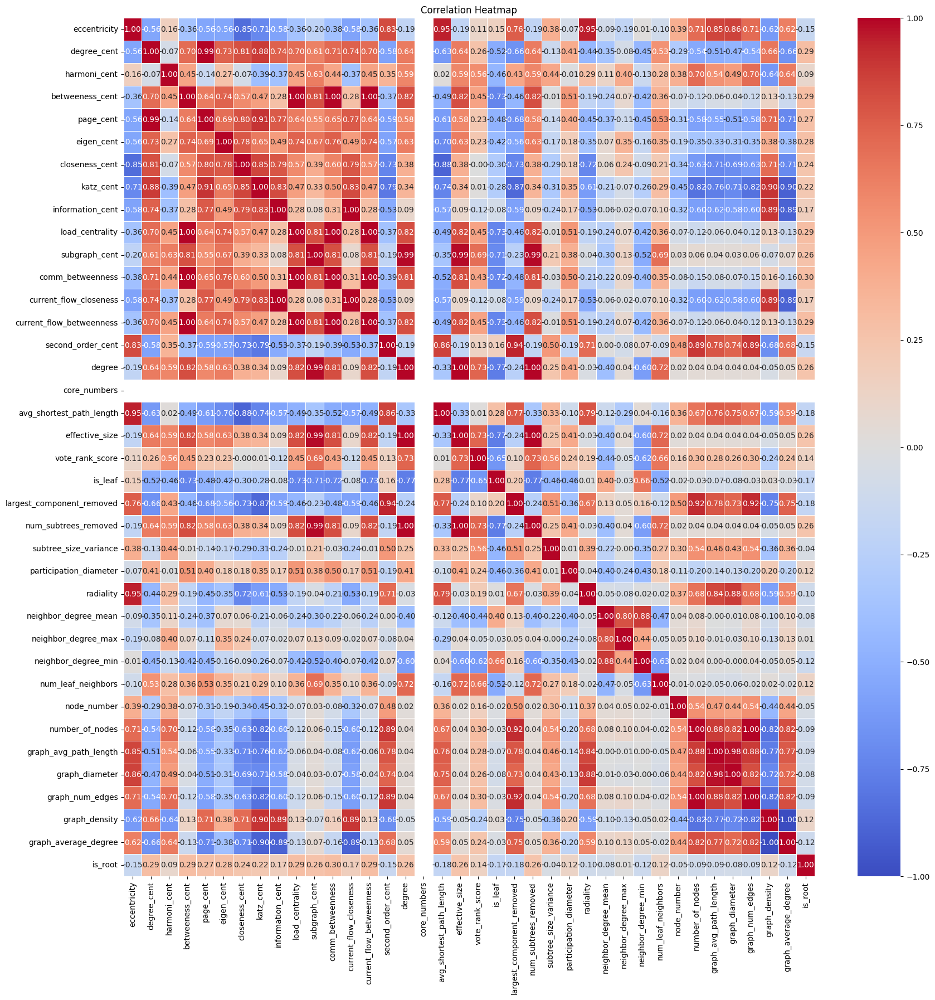

In [5]:
corr = df.drop(columns=['sentence','language','language_group']).corr()
plt.figure(figsize=(20, 20))
sns.heatmap(corr, annot=True, cmap='coolwarm', fmt=".2f", linewidths=0.5)
plt.title('Correlation Heatmap')
plt.show()

In [70]:
def get_highly_correlated_pairs(df, threshold=0.8):
    
    corr_matrix = df.corr().abs()

    
    upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(bool))

    
    high_corr = [
        (col1, col2, upper.loc[col1, col2])
        for col1 in upper.columns
        for col2 in upper.index
        if not pd.isna(upper.loc[col1, col2]) and upper.loc[col1, col2] > threshold
    ]

    
    high_corr.sort(key=lambda x: abs(x[2]), reverse=True)

    return high_corr

high_corr_pairs = get_highly_correlated_pairs(df.drop(columns=['sentence','language','language_group']), threshold=0.8)

for col1, col2, corr in high_corr_pairs:
    print(f"{col1} ↔ {col2} : {corr:.3f}")

graph_density ↔ graph_average_degree : 1.000
betweeness_cent ↔ current_flow_betweenness : 1.000
load_centrality ↔ current_flow_betweenness : 1.000
betweeness_cent ↔ load_centrality : 1.000
information_cent ↔ current_flow_closeness : 1.000
degree ↔ effective_size : 1.000
degree ↔ num_subtrees_removed : 1.000
effective_size ↔ num_subtrees_removed : 1.000
number_of_nodes ↔ graph_num_edges : 1.000
betweeness_cent ↔ comm_betweenness : 0.999
load_centrality ↔ comm_betweenness : 0.999
comm_betweenness ↔ current_flow_betweenness : 0.999
degree_cent ↔ page_cent : 0.995
subgraph_cent ↔ degree : 0.990
subgraph_cent ↔ effective_size : 0.990
subgraph_cent ↔ num_subtrees_removed : 0.990
graph_avg_path_length ↔ graph_diameter : 0.976
eccentricity ↔ radiality : 0.948
eccentricity ↔ avg_shortest_path_length : 0.946
second_order_cent ↔ largest_component_removed : 0.940
largest_component_removed ↔ number_of_nodes : 0.922
largest_component_removed ↔ graph_num_edges : 0.922
page_cent ↔ katz_cent : 0.905
ka

### Observations
1. is_root is correlated with node centrality features a lot and show little relation with total graph based features
2. eccentricity is highly correlated to graph based features so i think we can just use eccentricity instead of these features and also radiality can be removed.
3. degree centrality and pagerank centrality are also highly correlated

In [63]:
sample_df = df.drop(columns=['sentence','language_group','language','node_number','graph_avg_path_length','graph_diameter','graph_num_edges',
                             'graph_density','graph_average_degree','is_root','avg_shortest_path_length','radiality','degree_cent','number_of_nodes',\
                                'betweeness_cent','neighbor_degree_mean','core_numbers','subgraph_cent'])

In [64]:
df.columns

Index(['eccentricity', 'degree_cent', 'harmoni_cent', 'betweeness_cent',
       'page_cent', 'eigen_cent', 'closeness_cent', 'katz_cent',
       'information_cent', 'load_centrality', 'subgraph_cent',
       'comm_betweenness', 'current_flow_closeness',
       'current_flow_betweenness', 'second_order_cent', 'degree',
       'core_numbers', 'avg_shortest_path_length', 'effective_size',
       'vote_rank_score', 'is_leaf', 'largest_component_removed',
       'num_subtrees_removed', 'subtree_size_variance',
       'participation_diameter', 'radiality', 'neighbor_degree_mean',
       'neighbor_degree_max', 'neighbor_degree_min', 'num_leaf_neighbors',
       'node_number', 'sentence', 'language', 'language_group',
       'number_of_nodes', 'graph_avg_path_length', 'graph_diameter',
       'graph_num_edges', 'graph_density', 'graph_average_degree', 'is_root'],
      dtype='object')

In [65]:
X = add_constant(sample_df)
X = X.astype('float')

In [66]:
vif_data = pd.DataFrame()
vif_data['Feature'] = X.columns
vif_data['VIF'] = [variance_inflation_factor(X.values, i) for i in range(X.shape[1])]

/Users/nishantsushmakar/Documents/UPC/UPC-ML-Challenge/venv/lib/python3.13/site-packages/statsmodels/stats/outliers_influence.py:197: RuntimeWarning: divide by zero encountered in scalar divide
  vif = 1. / (1. - r_squared_i)


In [67]:
vif_data

,Feature,VIF
0,const,1686.136886
1,eccentricity,10.633719
2,harmoni_cent,30.040138
3,page_cent,69.219264
4,eigen_cent,7.362091
5,closeness_cent,29.811578
6,katz_cent,73.068550
7,information_cent,inf
8,load_centrality,inf
9,comm_betweenness,7500.660722


In [8]:
numerical_cols = df.drop(columns=['sentence']).select_dtypes(include='number').columns

# Exclude 'is_root' from the feature list if it's numeric (since we'll use it as hue)
features = [col for col in numerical_cols if col != 'is_root']

In [9]:
features

['eccentricity',
 'degree_cent',
 'harmoni_cent',
 'betweeness_cent',
 'page_cent',
 'eigen_cent',
 'closeness_cent',
 'katz_cent',
 'information_cent',
 'load_centrality',
 'subgraph_cent',
 'comm_betweenness',
 'current_flow_closeness',
 'current_flow_betweenness',
 'second_order_cent',
 'degree',
 'core_numbers',
 'avg_shortest_path_length',
 'effective_size',
 'vote_rank_score',
 'largest_component_removed',
 'num_subtrees_removed',
 'subtree_size_variance',
 'radiality',
 'neighbor_degree_mean',
 'neighbor_degree_max',
 'neighbor_degree_min',
 'num_leaf_neighbors',
 'node_number',
 'number_of_nodes',
 'graph_avg_path_length',
 'graph_diameter',
 'graph_num_edges',
 'graph_density',
 'graph_average_degree']

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


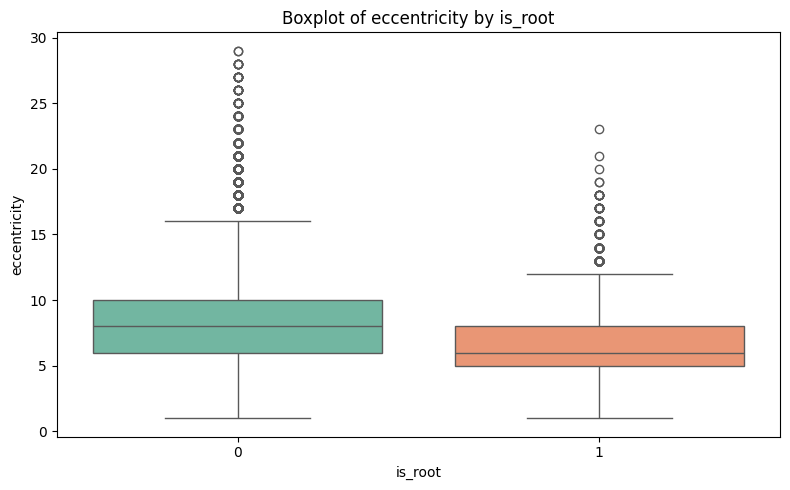

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


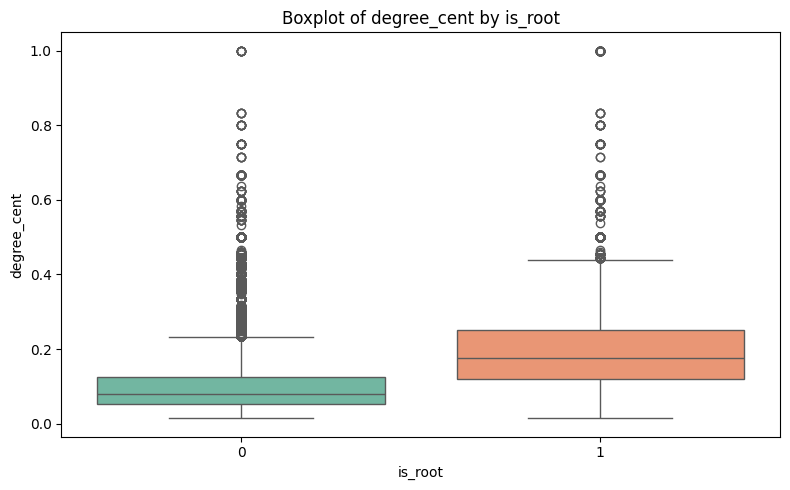

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


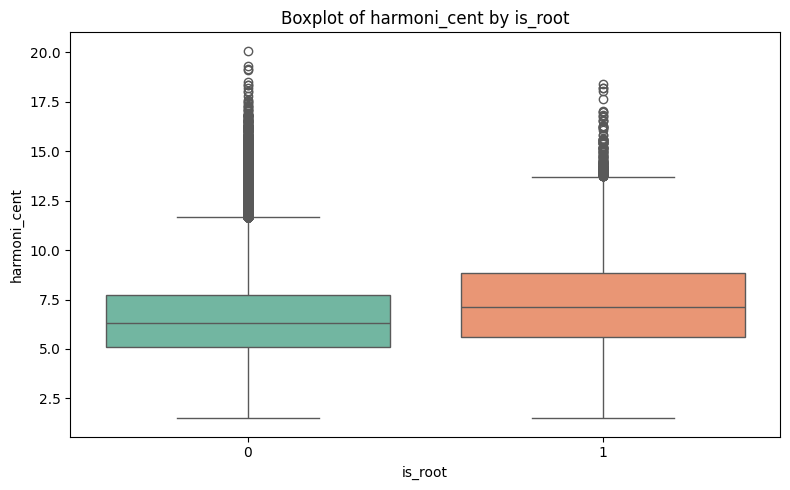

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


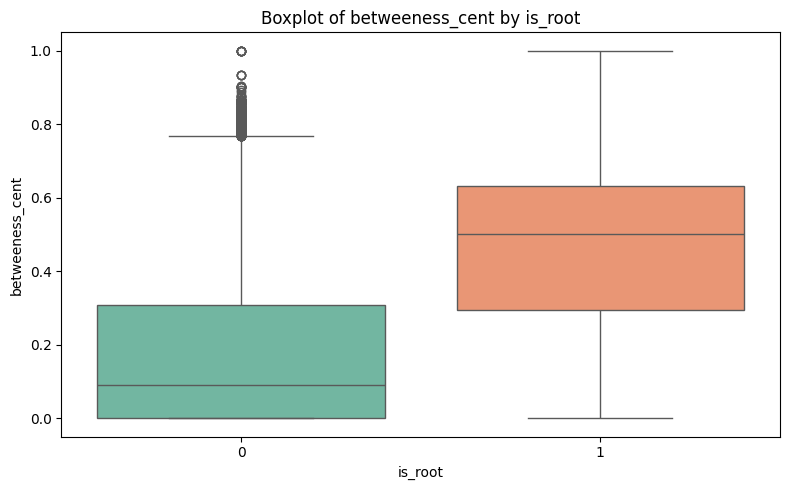

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


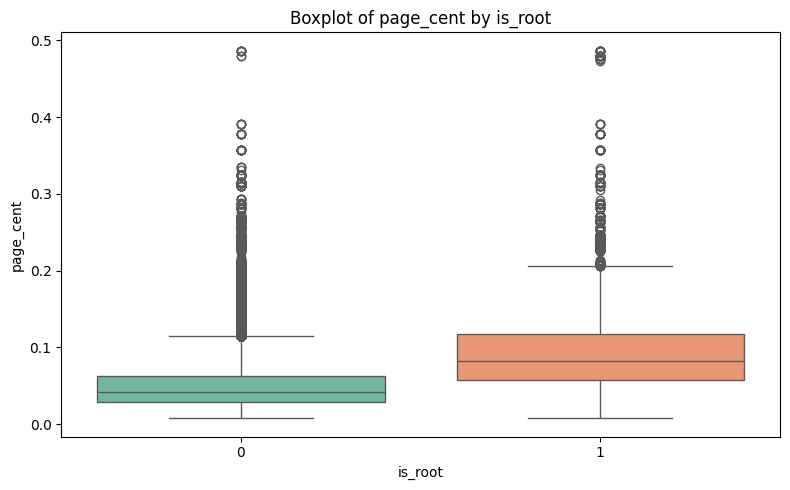

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


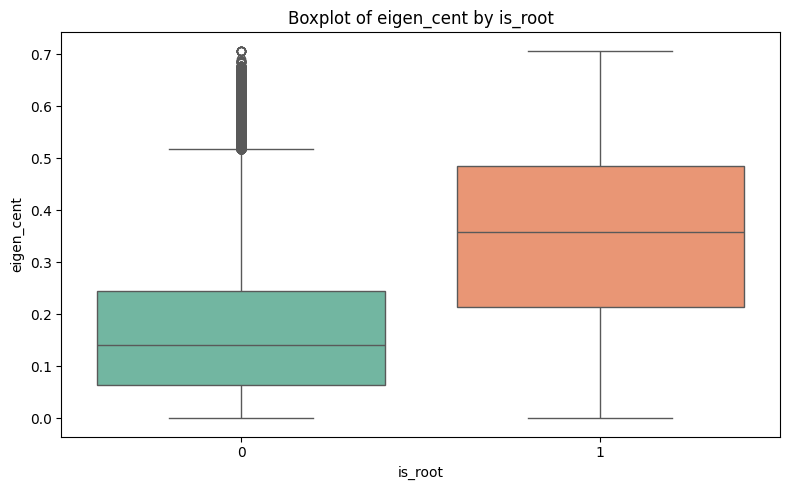

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


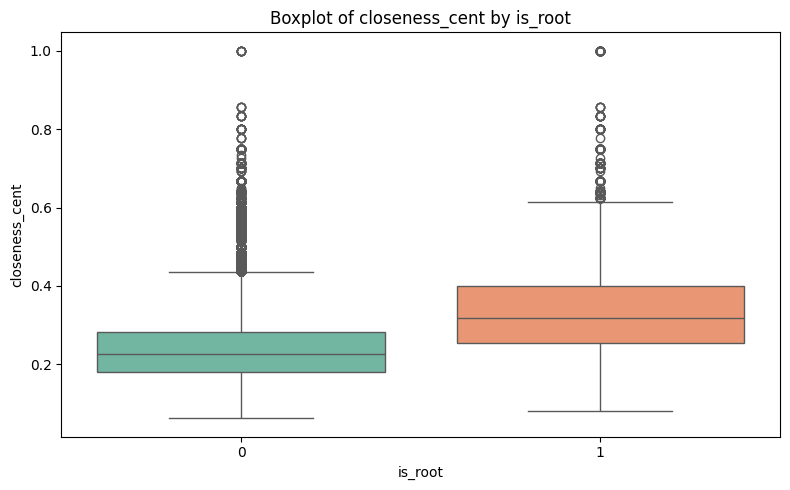

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


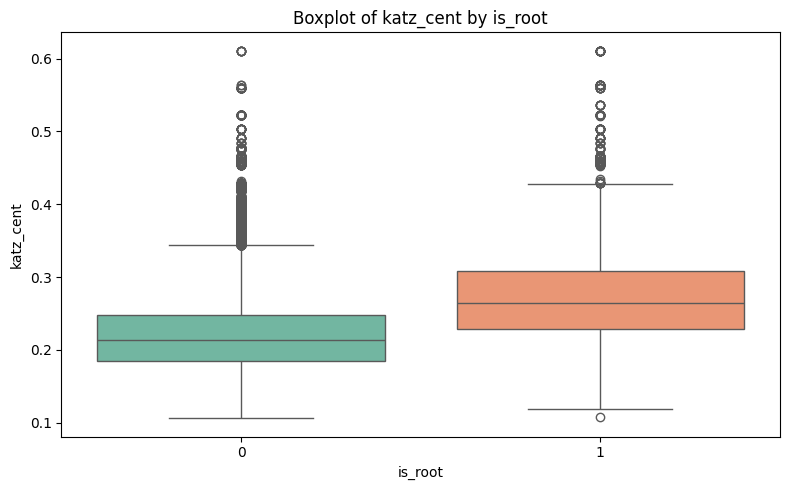

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


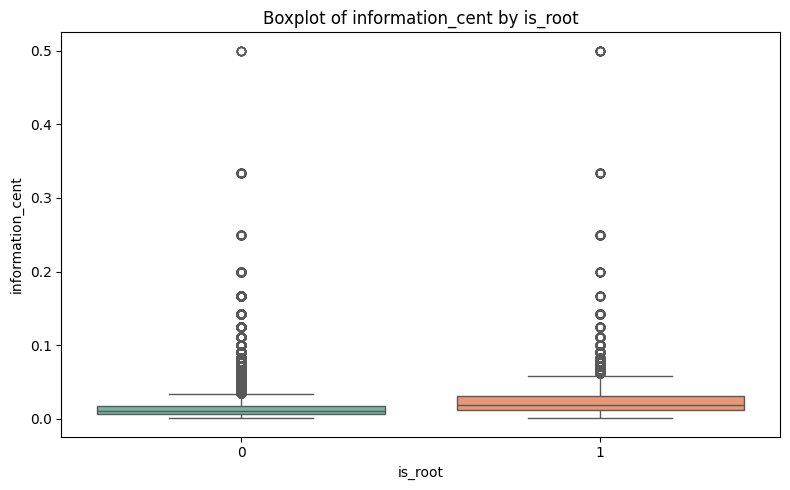

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


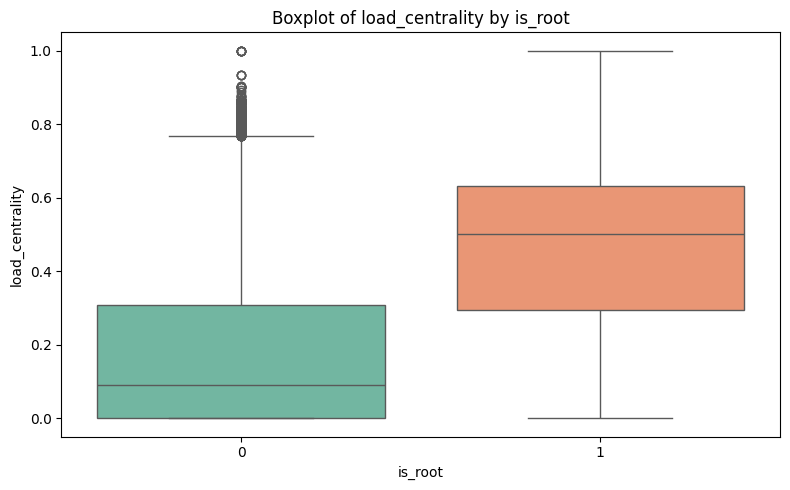

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


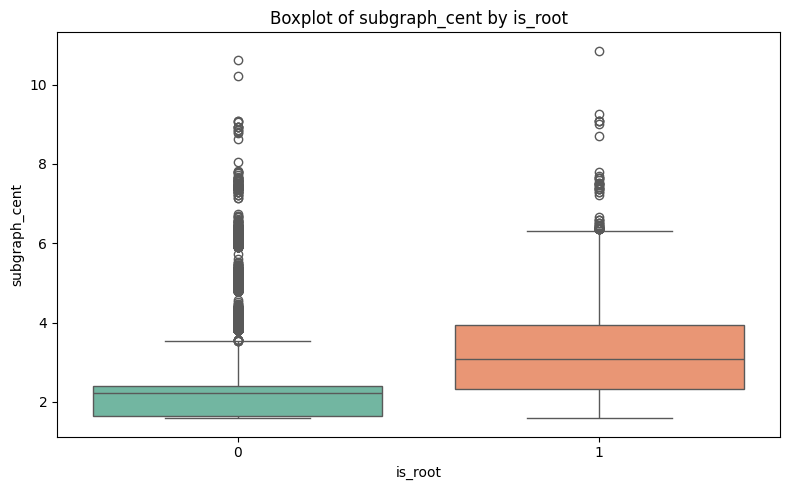

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


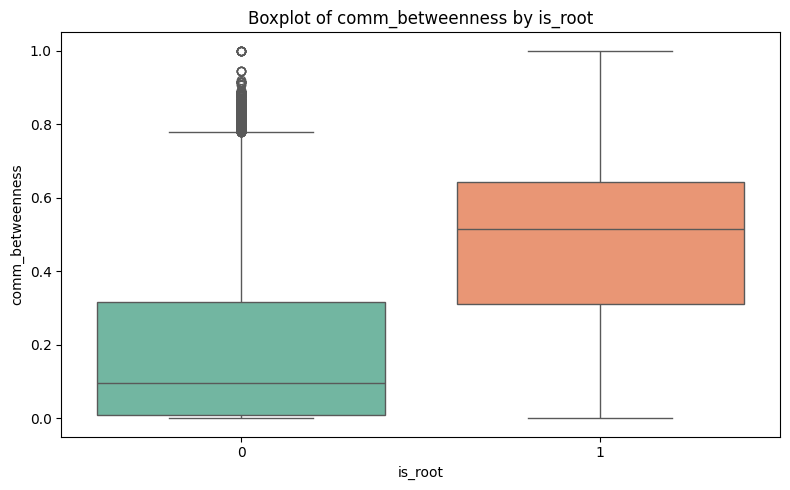

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


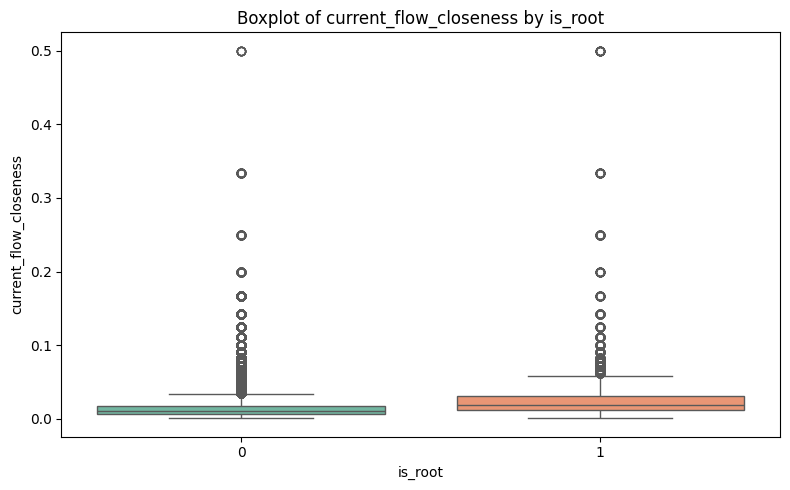

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


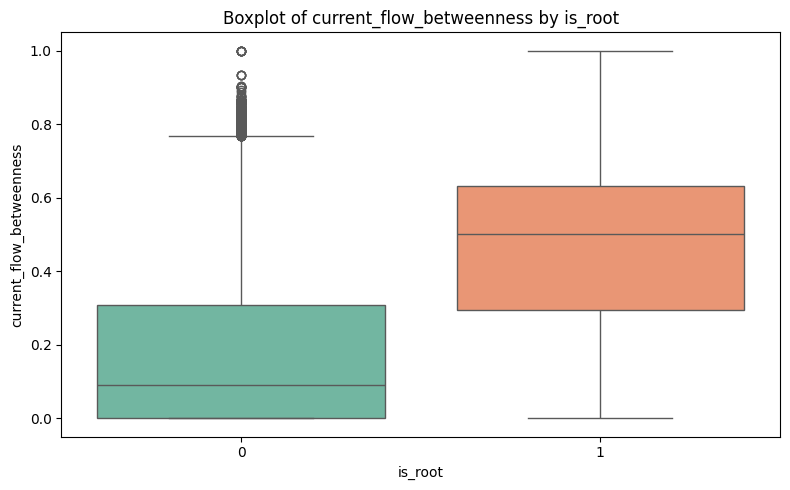

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


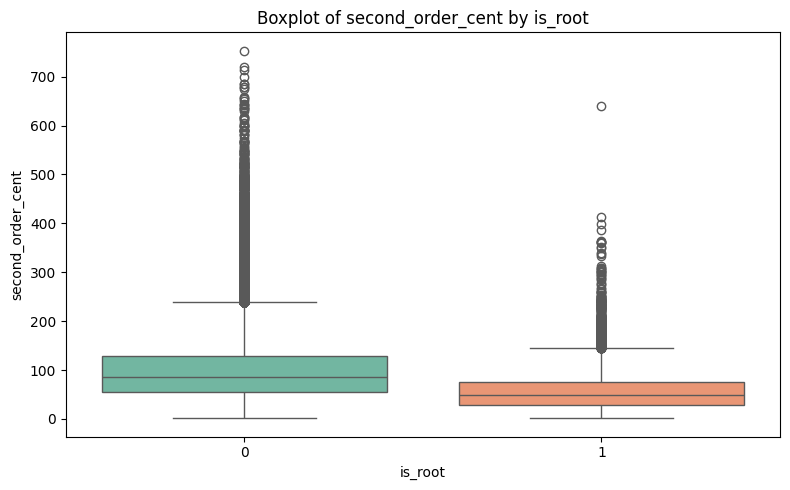

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


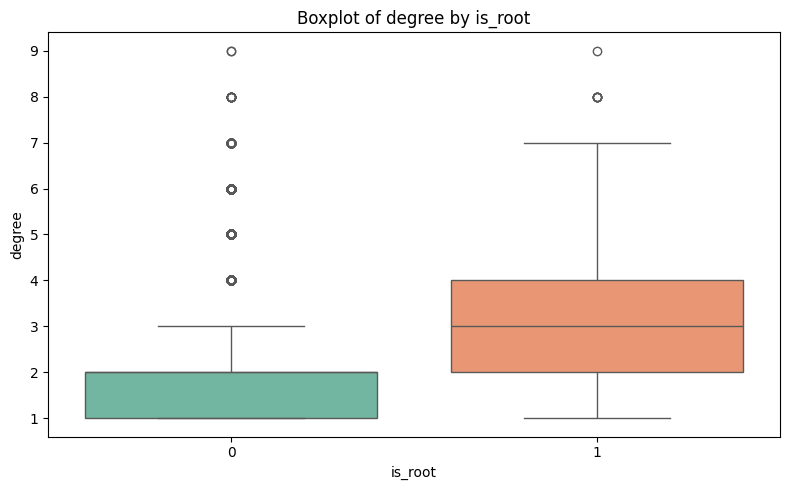

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


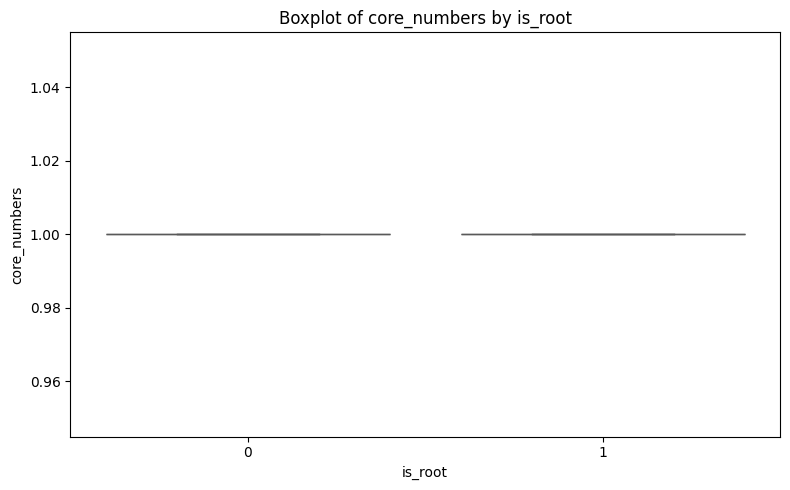

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


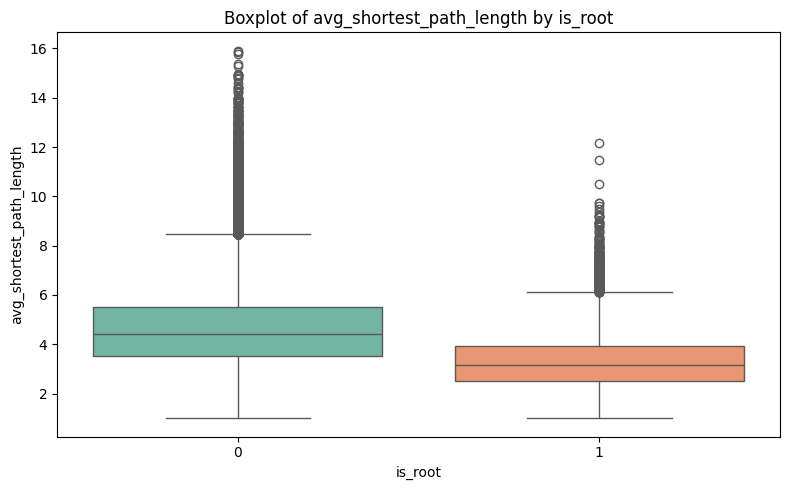

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


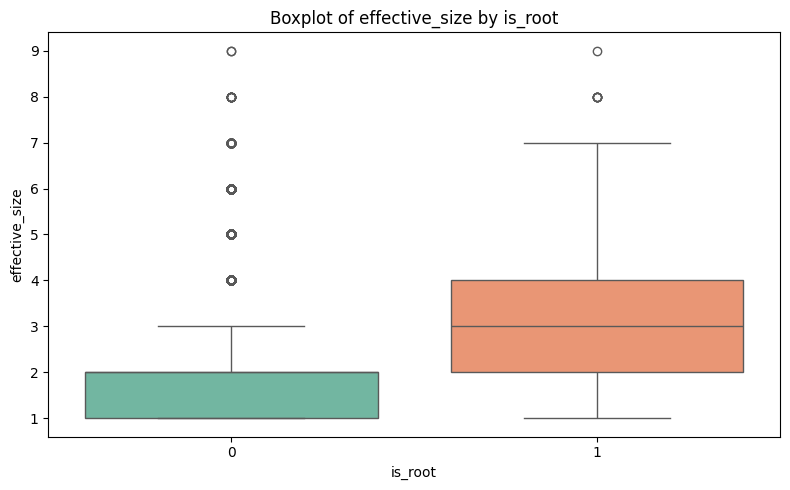

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


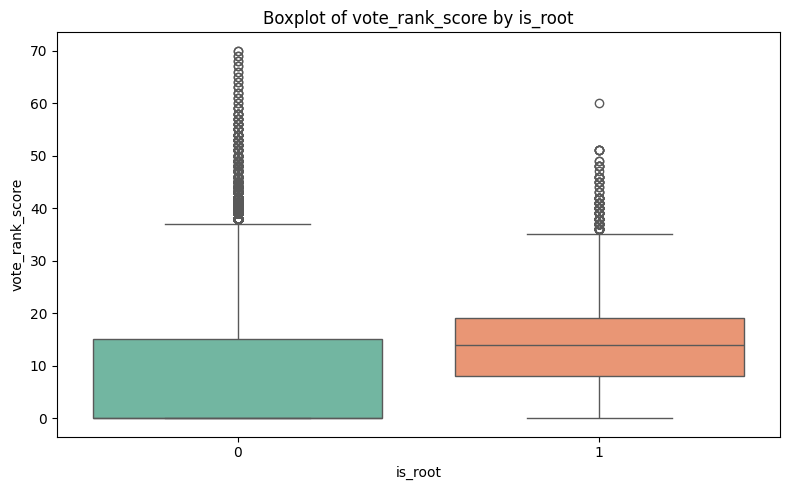

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


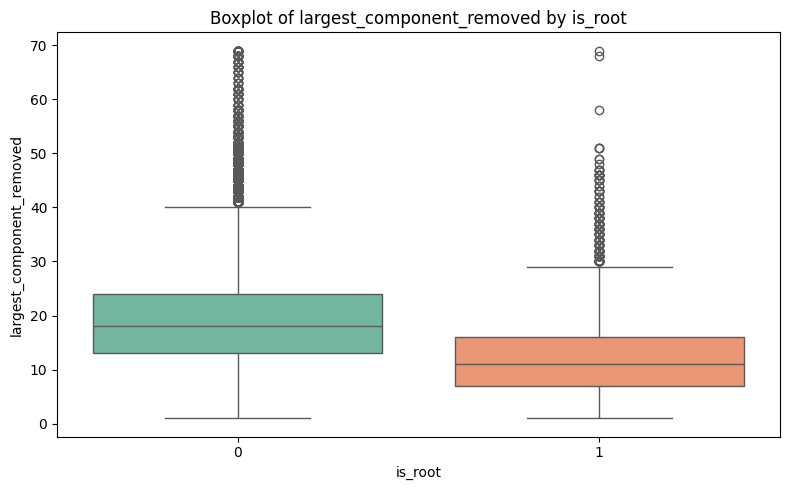

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


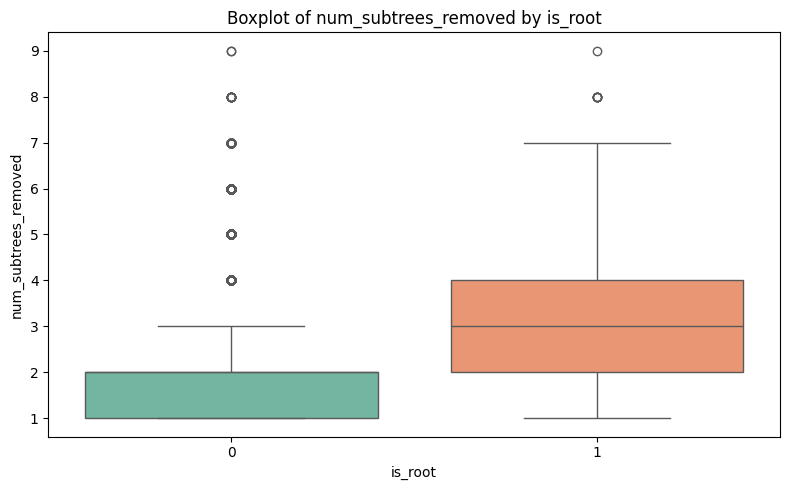

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


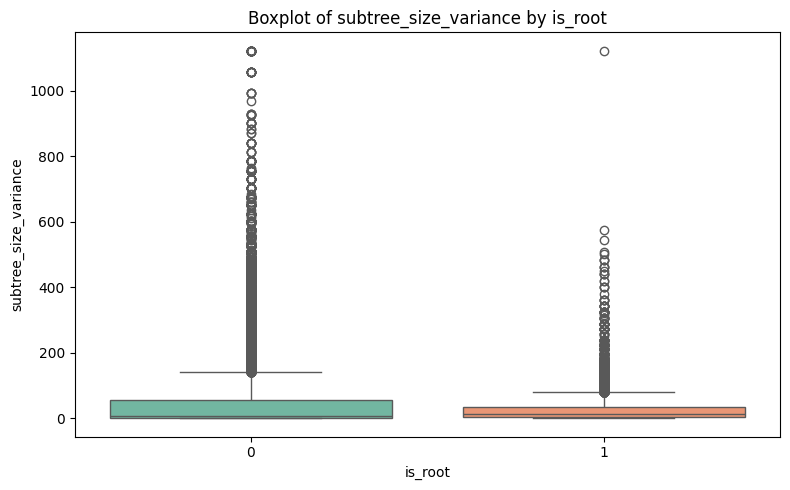

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


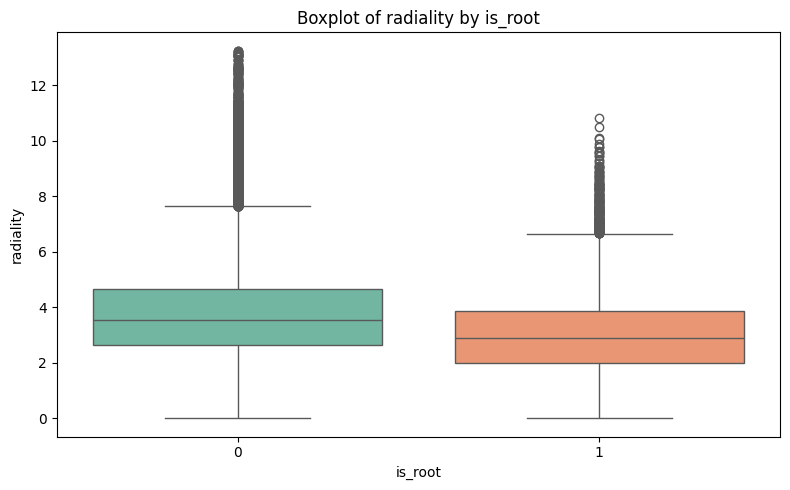

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


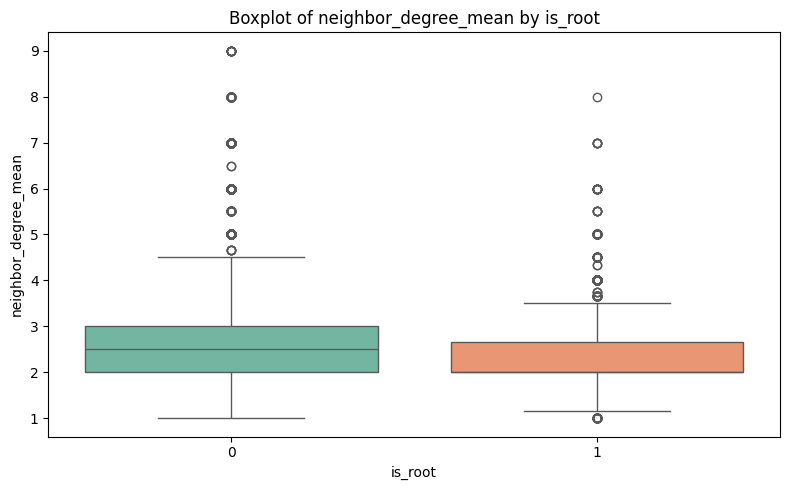

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


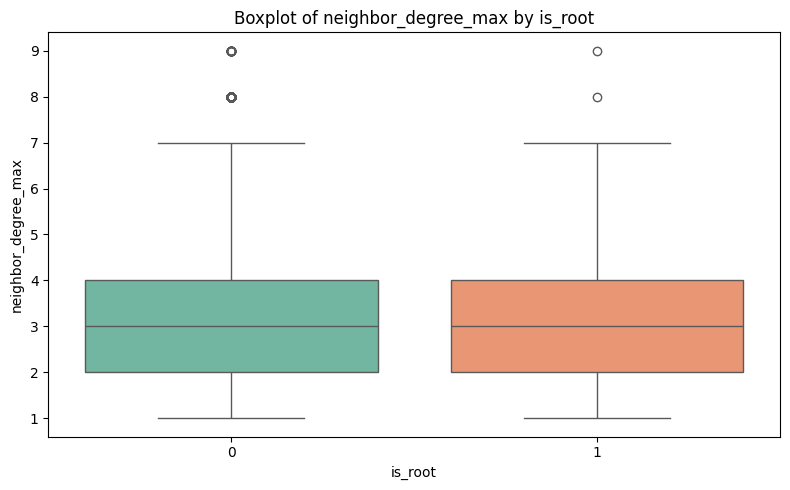

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


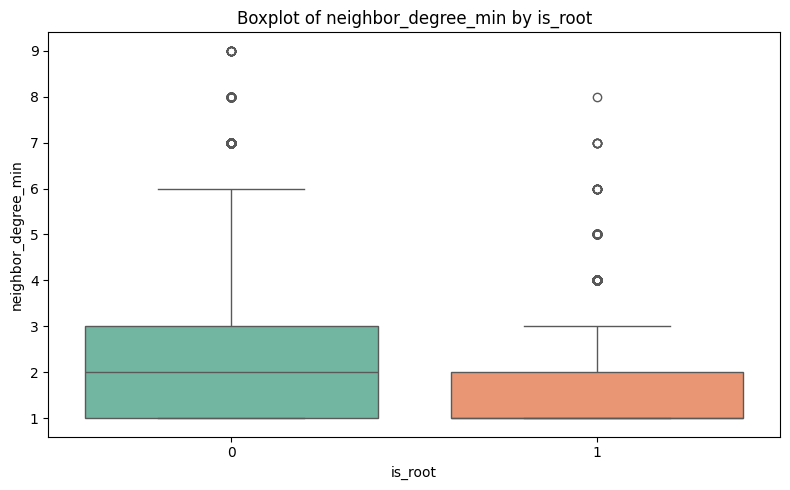

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


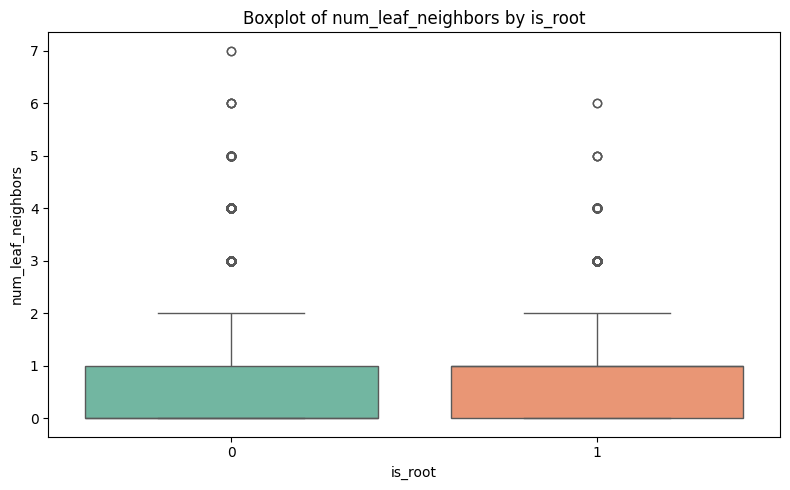

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


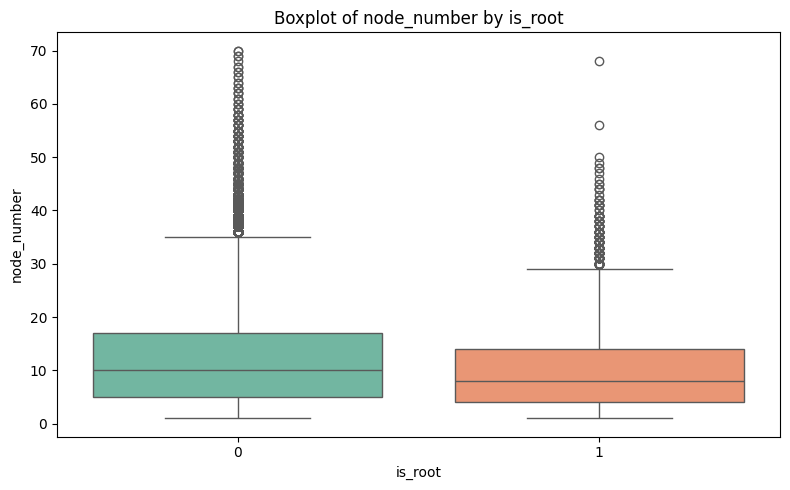

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


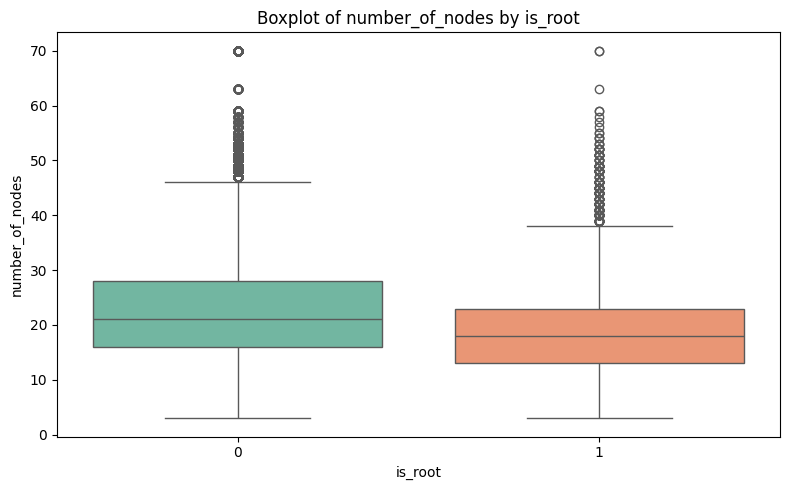

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


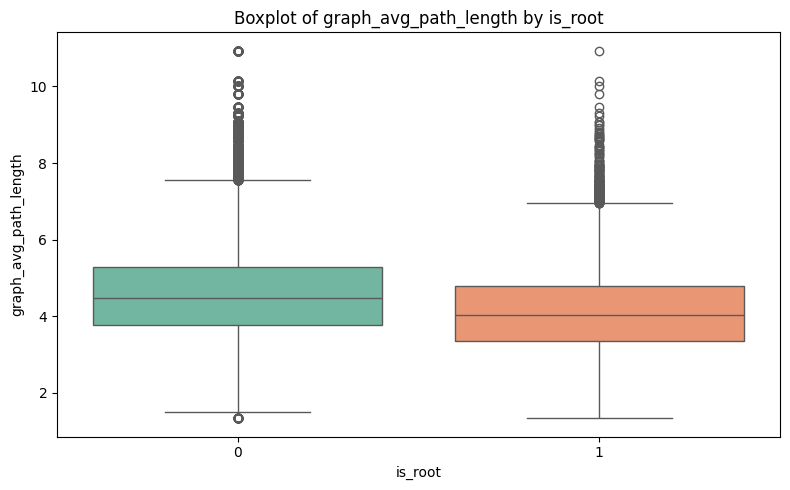

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


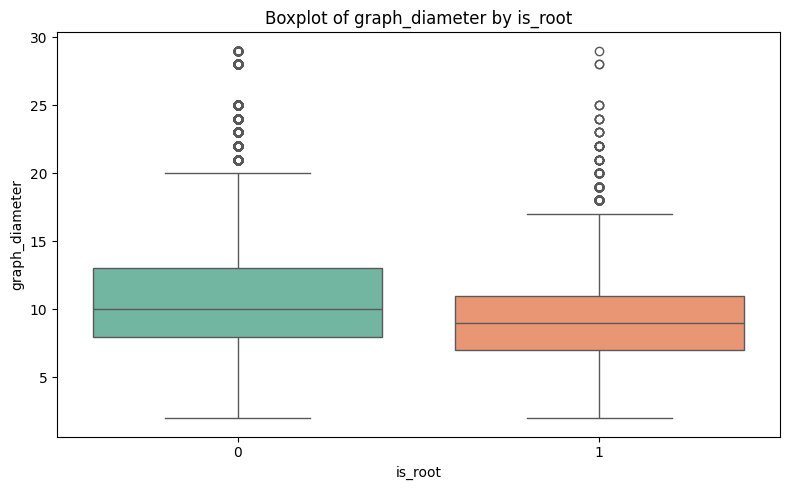

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


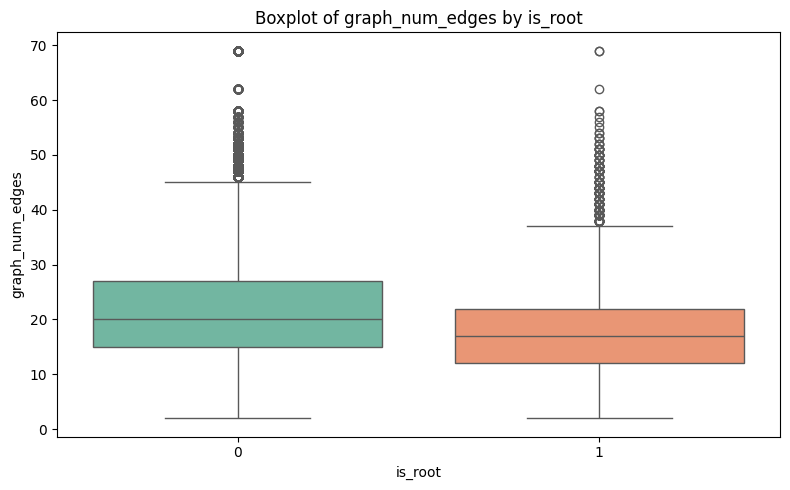

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


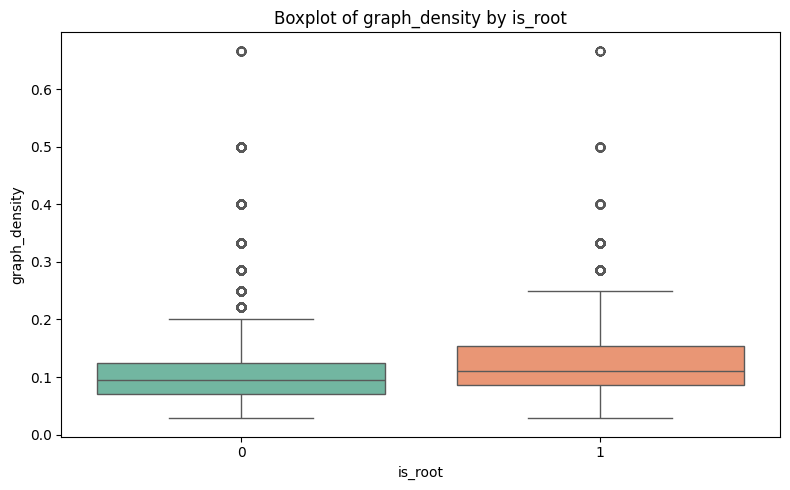

/var/folders/51/y2_6x05j1hjgtnzwshx1dgt80000gn/T/ipykernel_97311/2808101637.py:3: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')


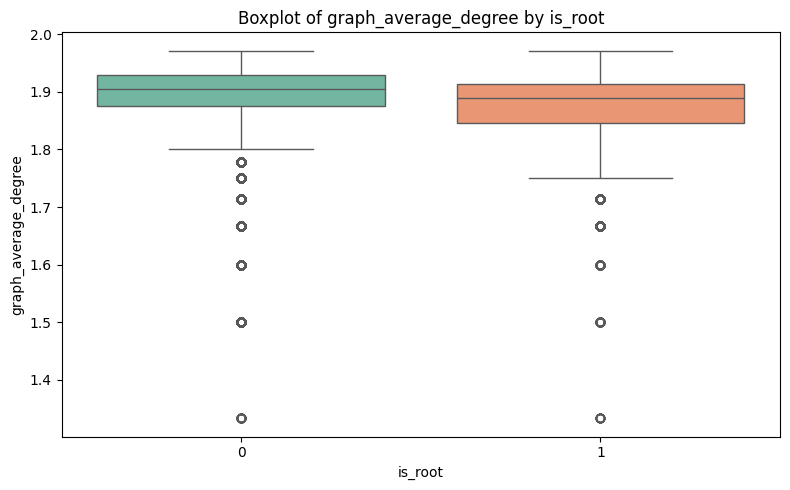

In [10]:
for feature in features:
    plt.figure(figsize=(8, 5))
    sns.boxplot(data=df, x='is_root', y=feature, palette='Set2')
    plt.title(f'Boxplot of {feature} by is_root')
    plt.xlabel('is_root')
    plt.ylabel(feature)
    plt.tight_layout()
    plt.show()

1. Number of subtrees removed have a distinguishing importance for root node
2. All the centralitiy features are able to separate out the root nodes

In [71]:
def plot_pairplot(df, hue_column, vars=None, sample_frac=1.0):
    """
    Generates a Seaborn pairplot with a specified hue.
    
    Parameters:
        df (pd.DataFrame): Your DataFrame
        hue_column (str): Column name to use as hue
        vars (list): List of variables (columns) to include. If None, all numeric columns are used.
        sample_frac (float): Fraction of the data to use (useful for large datasets)
    """
    # Optional: sample data for speed if it's too big
    if sample_frac < 1.0:
        df = df.sample(frac=sample_frac, random_state=42)

    # Plot
    sns.pairplot(df, hue=hue_column, vars=vars, diag_kind='kde', corner=True)
    plt.show()

In [72]:
plot_pairplot(df, hue_column='is_root', sample_frac=0.5)

## Feature Importance

In [17]:
import joblib

# Load the model
with open('../resources/lgbm/lgbm_4.pkl', 'rb') as f:
    model = joblib.load(f)

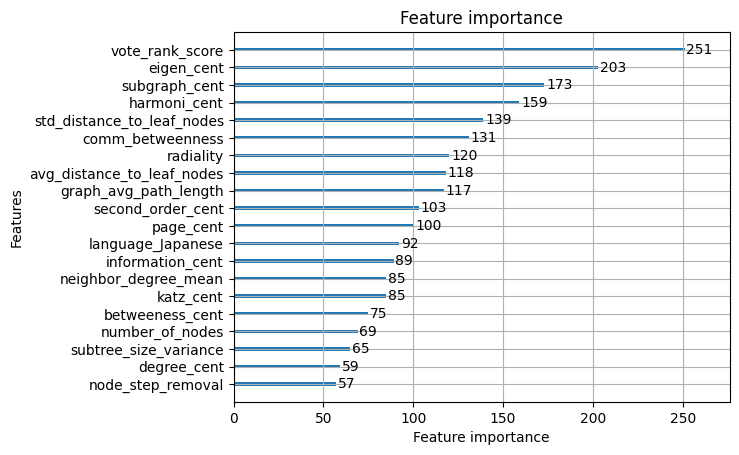

In [18]:
import lightgbm as lgb

# If you want a quick plot:
lgb.plot_importance(model, max_num_features=20)  # You can change max_num_features as you like
plt.show()

In [20]:
importances = model.feature_importances_
feature_names = model.feature_name_


importance_df = pd.DataFrame({
    'feature': feature_names,
    'importance': importances
})

importance_df = importance_df.sort_values(by='importance', ascending=False).reset_index(drop=True)

In [23]:
importance_df[importance_df['importance']<10]['feature'].tolist()

['language_Thai',
 'language_group_Slavic',
 'language_Finnish',
 'language_Arabic',
 'language_French',
 'language_Italian',
 'language_Czech',
 'is_centroid',
 'language_Swedish',
 'graph_density',
 'language_Polish',
 'degree',
 'language_German',
 'language_Portuguese',
 'language_Russian',
 'language_English',
 'language_Galician',
 'language_Indonesian',
 'subtree_size_std',
 'language_group_Austronesian',
 'language_group_Semitic',
 'language_Spanish',
 'language_group_Kra-Dai',
 'language_group_Sino-Tibetan',
 'language_group_Koreanic',
 'language_group_Japonic',
 'language_group_Turkic',
 'language_group_Indo-Aryan',
 'min_subtree_depth',
 'graph_average_degree',
 'graph_num_edges',
 'subtree_depth_std',
 'subtree_depth_balance',
 'max_subtree_depth',
 'num_subtrees',
 'max_subtree_size',
 'distance_to_farthest_leaf',
 'max_distance_to_any_node',
 'max_height',
 'num_subtrees_removed',
 'is_leaf',
 'effective_size',
 'current_flow_closeness',
 'load_centrality',
 'language_gro